In [8]:
import sys
sys.path.append("/Users/jameskitchens/Documents/GitHub/terracotta")
import terracotta as tct
import tskit
import pandas as pd
import numpy as np
import dataclasses

In [9]:
@dataclasses.dataclass
class ARG:
    parent_range: list
    child_range: list
    parent_index: list

    def __str__(self):
        s = "id\tchild\tparent\n"
        for j in range(len(self.parent_range)):
            s += f"{j}\t" f"{self.child_range[j]}\t" f"{self.parent_range[j]}\t" "\n"
        return s


def make_arg(ts):
    arg = ARG(
        child_range=np.zeros((ts.num_nodes, 2), dtype=np.int32) - 1,
        parent_range=np.zeros((ts.num_nodes, 2), dtype=np.int32) - 1,
        parent_index=None,
    )
    last_parent = -1
    for edge in ts.edges():
        if edge.parent != last_parent:
            arg.child_range[edge.parent, 0] = edge.id
            if last_parent != -1:
                arg.child_range[last_parent, 1] = edge.id
        last_parent = edge.parent
    if last_parent != -1:
        arg.child_range[last_parent, 1] = ts.num_edges

    # Group together all parent edges for a given child.
    # Here we're sorting by left-coordinate first, so that we can find the
    # parent of a node at a give position quickly.
    arg.parent_index = np.lexsort((ts.edges_parent, ts.edges_left, ts.edges_child))

    last_child = -1
    for j, e in enumerate(arg.parent_index):
        edge = ts.edge(e)
        if edge.child != last_child:
            arg.parent_range[edge.child, 0] = j
            if last_child != -1:
                arg.parent_range[last_child, 1] = j
        last_child = edge.child

    if last_child != -1:
        arg.parent_range[last_child, 1] = ts.num_edges
    return arg

def unique_ancestral_lineages(ts, arg, u):
    """
    Returns list of ancestral lineages above a specified node. Note that this
    does not require that the node inherited any genetic material.
    """
    parent_range = range(*arg.parent_range[u])
    if parent_range == range(-1,-1):
        return [np.array([u])]
    lineages = []
    previous = []
    for j in parent_range:
        e = arg.parent_index[j]
        e_parent = ts.edges_parent[e]
        if e_parent not in previous:    #ignore duplicate child-parent edges
            previous.append(e_parent)
            for line in unique_ancestral_lineages(ts, arg, e_parent):
                lineages.append(np.append(np.array([u]), line))
    return lineages

In [34]:
demes = pd.read_csv("dataset/demes.tsv", sep="\t")
samples = pd.read_csv("dataset/samples.tsv", sep="\t")
world_map = tct.WorldMap(demes, samples)
ts = tskit.load("dataset/arg.trees")
#ts = ts.keep_intervals([(0, 10000)]).trim()
#print(ts)
#arg = make_arg(ts)
#print(len(unique_ancestral_lineages(ts, arg, 0)))
#ts_0 = ts.simplify(samples=[0], keep_unary=True)
#print(ts_0)

In [35]:
edge_table = ts.tables.edges
for node in ts.nodes():
    num_parents = len(np.where(edge_table.child == node.id)[0])
    if num_parents > 2:
        print(node.id)

7045
7513



KeyboardInterrupt



In [27]:
sys.path.append("/Users/jameskitchens/Documents/GitHub/tskit_arg_visualizer")
import tskit_arg_visualizer as tsviz

In [28]:
d3arg = tsviz.D3ARG.from_ts(ts_0)
d3arg.draw(width=1000)

In [57]:
path = []
time = []
deme = []
for p in paths:
    ts = tskit.load(p)
    a = 0
    while a != -1:
        path.append(p)
        time.append(ts.node(a).time)
        deme.append(int(ts.population(ts.node(a).population).metadata["name"].split("_")[-1]))
        a = ts.first().parent(a)

In [58]:
df = pd.DataFrame({"file":path, "time":time, "deme":deme})

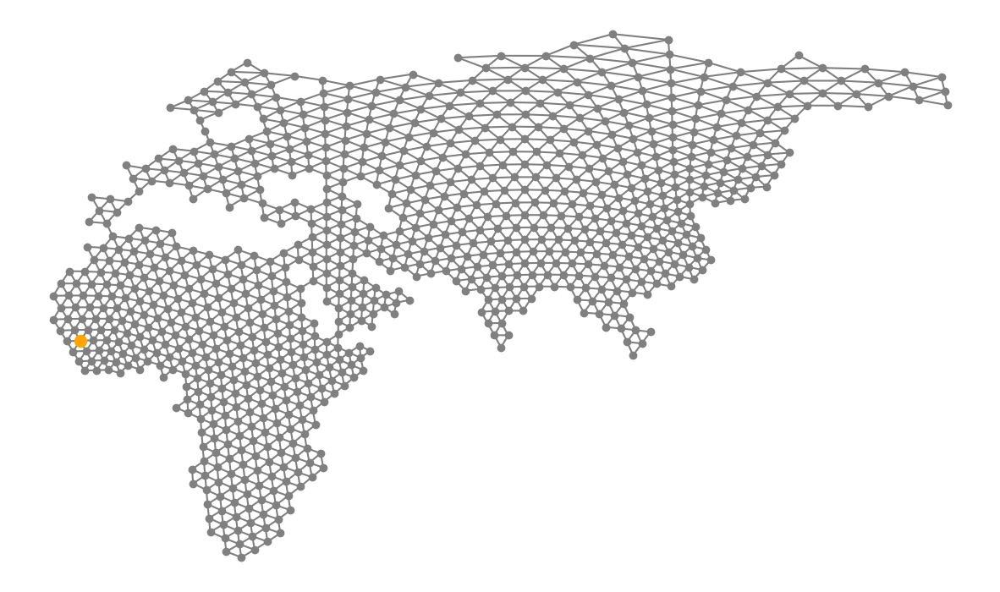

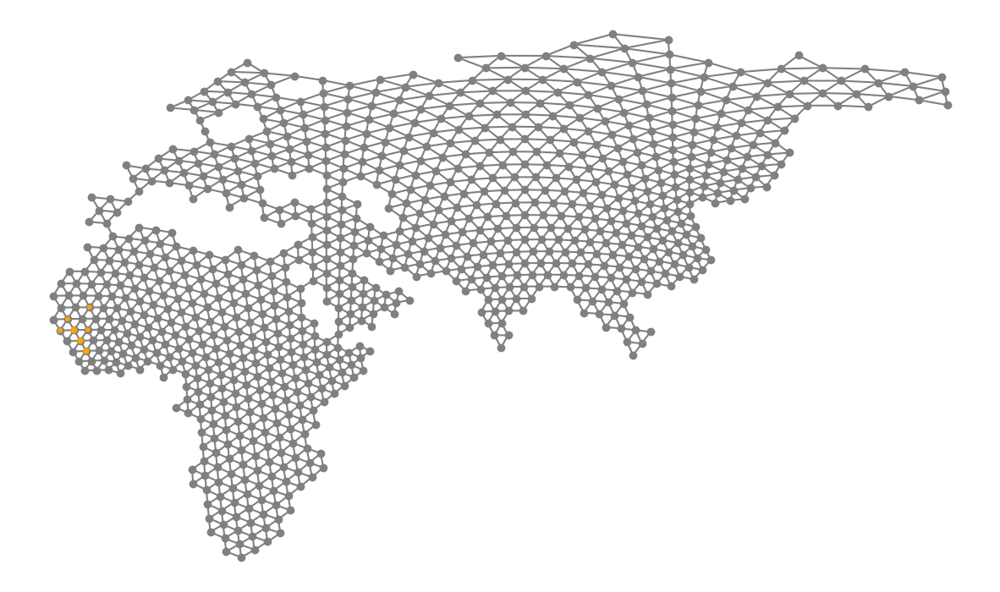

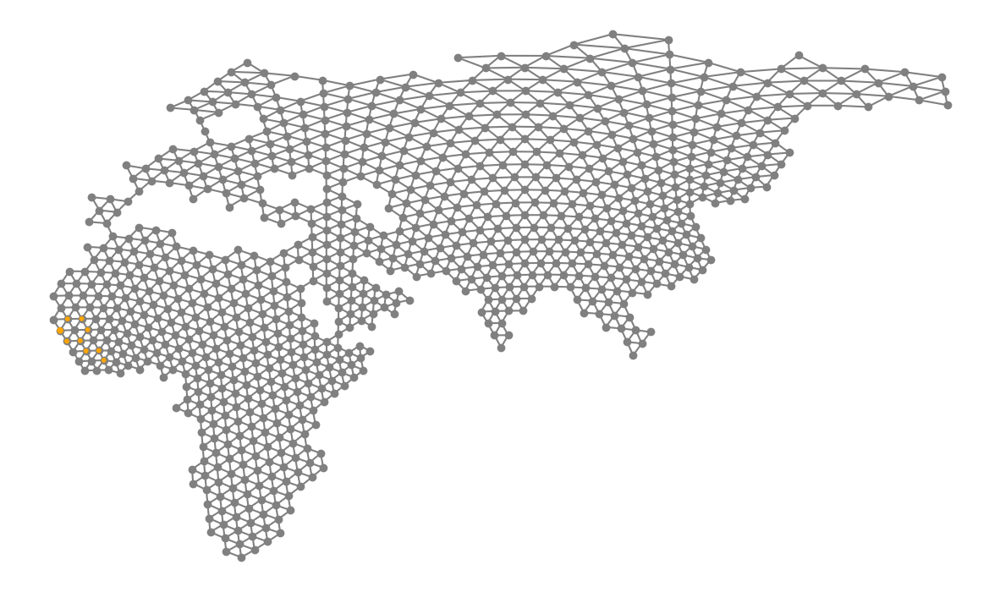

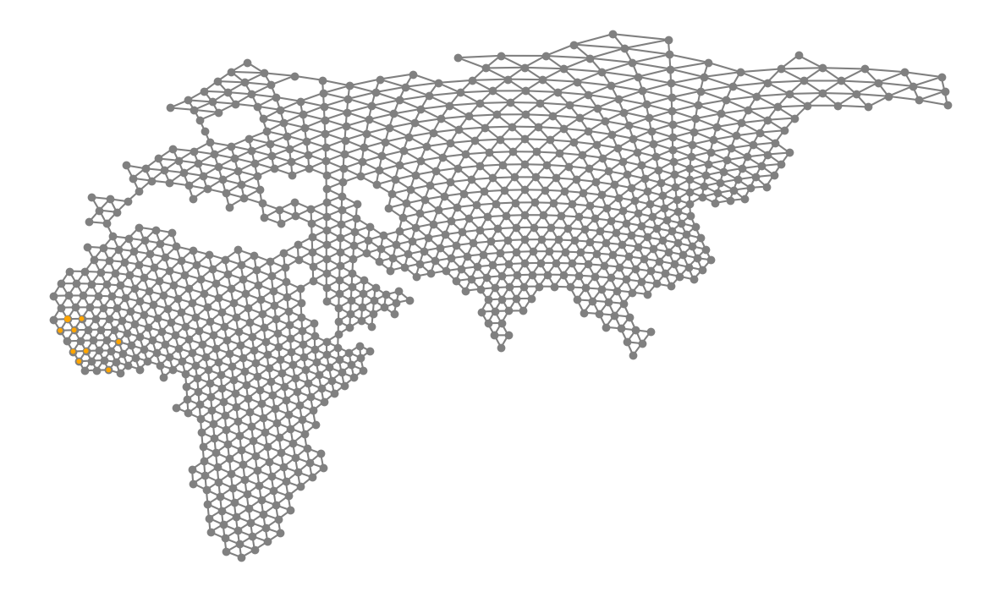

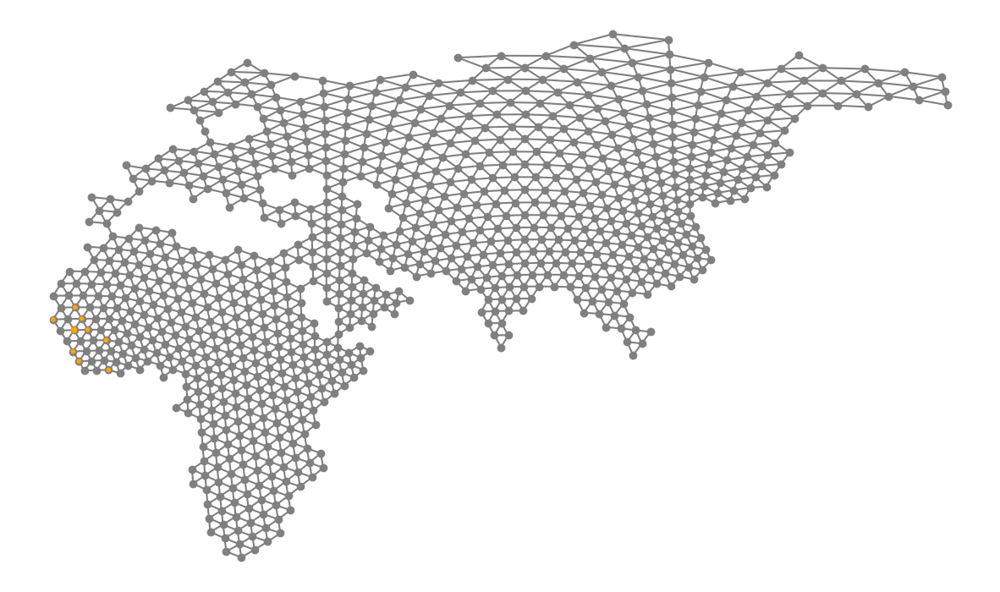

...

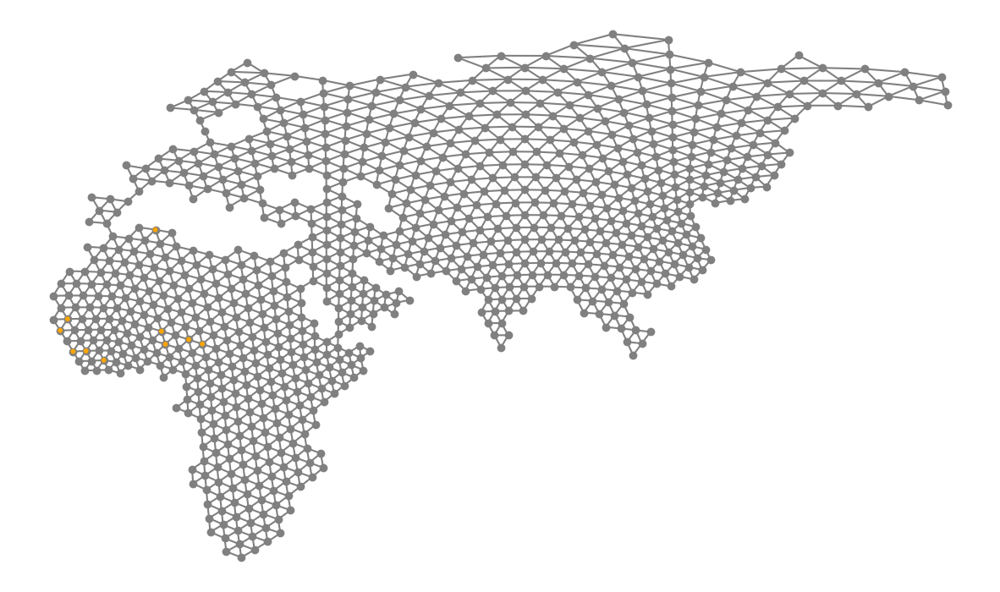

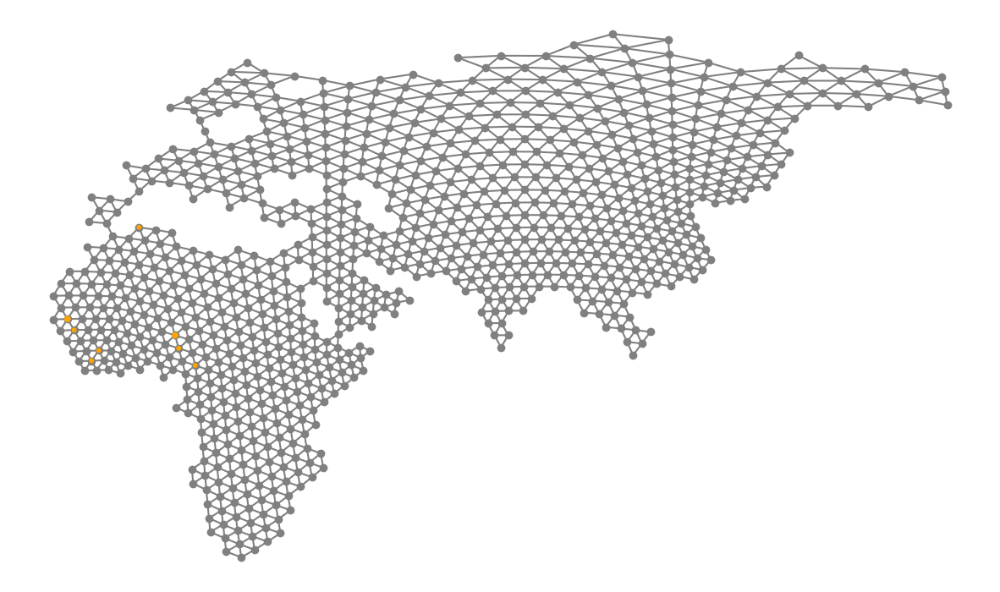

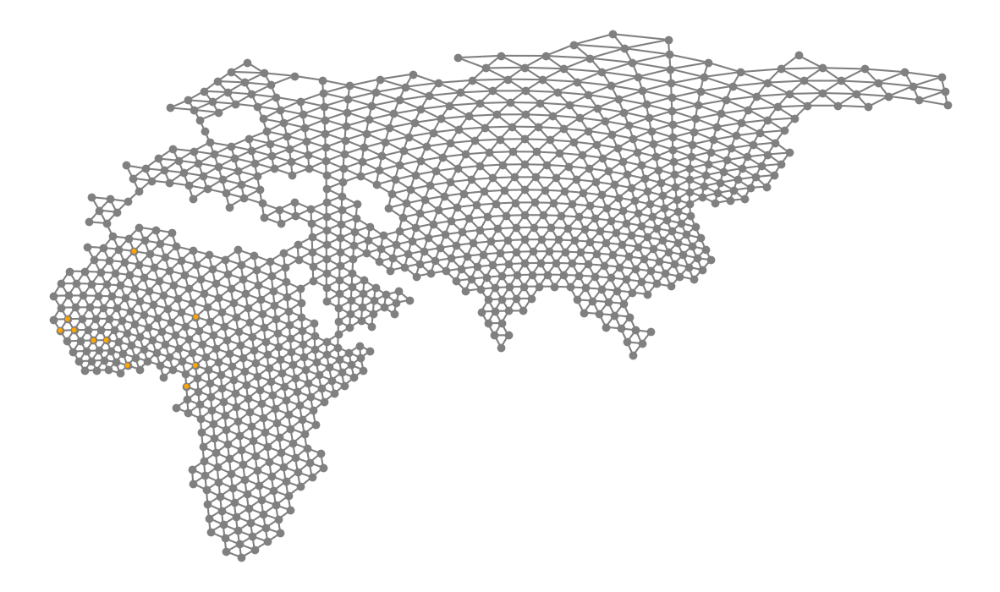

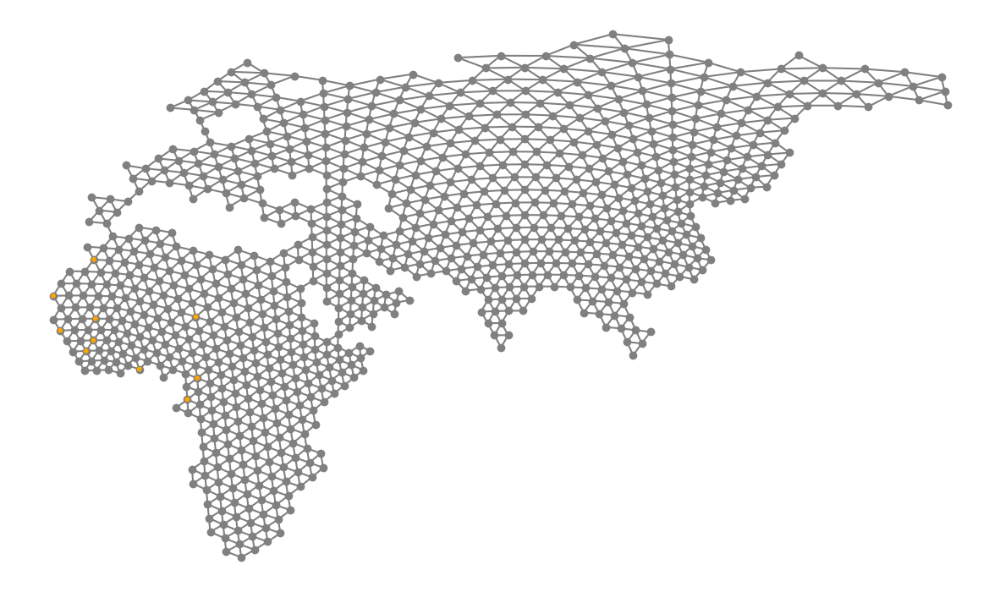

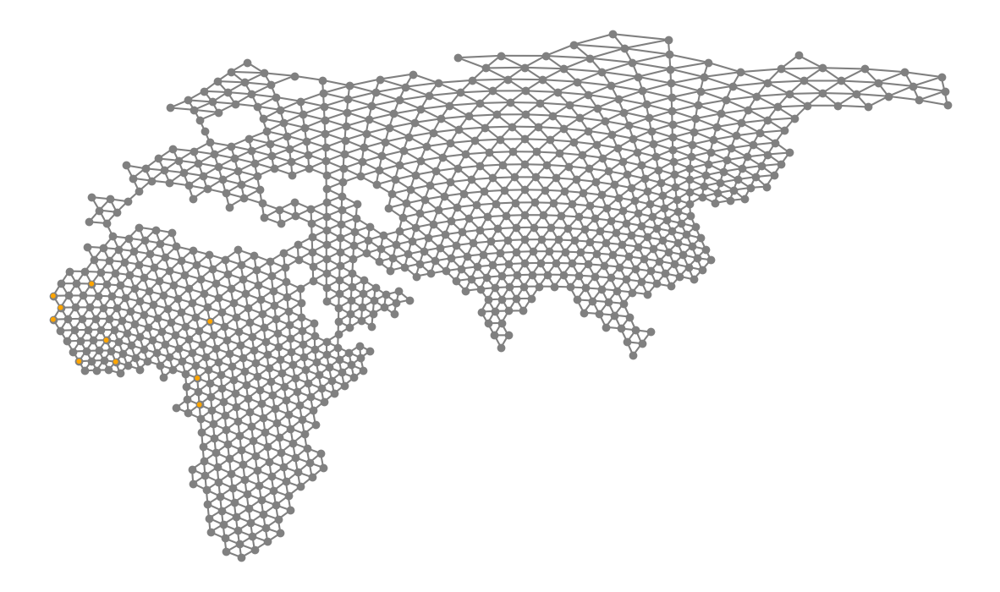

Exception ignored in: <bound method IPythonKernel._clean_thread_parent_frames of <ipykernel.ipkernel.IPythonKernel object at 0x10c7a7500>>
Traceback (most recent call last):
  File "/opt/anaconda3/envs/terracotta/lib/python3.12/site-packages/ipykernel/ipkernel.py", line 775, in _clean_thread_parent_frames
    def _clean_thread_parent_frames(

KeyboardInterrupt: 

KeyboardInterrupt

Exception ignored in: 'zmq.backend.cython._zmq.Frame.__dealloc__'
Traceback (most recent call last):
  File "_zmq.py", line 169, in zmq.backend.cython._zmq._check_rc
Traceback (most recent call last):
  File "_zmq.py", line 169, in zmq.backend.cython._zmq._check_rc
KeyboardInterrupt
KeyboardInterrupt: 


KeyboardInterrupt: 

Error in callback <function _draw_all_if_interactive at 0x1173e3f60> (for post_execute), with arguments args (),kwargs {}:


In [ ]:
for time in range(0, 4050, 50):
    points = []
    for p in paths:
        filtered = df.loc[df["file"]==p,:].loc[df["time"]<=time,:]
        deme = filtered.loc[filtered["time"]==filtered["time"].max(),"deme"].iloc[0]
        points.append(deme)
    world_map.draw(figsize=(15,15), add_points=points)